In [1]:
import datetime

import numpy as np
import pandas as pd
import xarray as xr
# import xgcm
import cftime

from matplotlib import pyplot as plt
from plotly import figure_factory as ff
from plotly import graph_objects as go

import MITgcmutils as mutil

In [2]:
trajdir = '/data/oceanparcels/output_data/data_Daan/project_diffusion/dispersion/'

In [3]:
topography = mutil.rdmds("/data/oceanparcels/input_data/MITgcm/ACC_channel/ACC_ridge_coarse_5y_loca/Depth")

In [4]:
traj_fine = xr.open_dataset(trajdir + "absolute_dispersion_ACC_ridge_fine_advection_180d_dt40m.nc", decode_times=False).isel(obs=slice(0,721))
traj_coarsened = xr.open_dataset(trajdir + "absolute_dispersion_ACC_ridge_coarsened_advection_180d_dt40m.nc", decode_times=False).isel(obs=slice(0,721))
traj_coarse = xr.open_dataset(trajdir + "absolute_dispersion_ACC_ridge_coarse_advection_180d_dt40m.nc", decode_times=False)
traj_coarse_markov1 = xr.open_dataset(trajdir + "absolute_dispersion_ACC_ridge_coarse_180d_Markov1_K15000_dt40m.nc", decode_times=False)
traj_coarsened_markov1 = xr.open_dataset(trajdir + "absolute_dispersion_ACC_ridge_coarsened_180d_Markov1_K15000_dt40m.nc", decode_times=False)
traj_coarsened_Redi = xr.open_dataset(trajdir + "absolute_dispersion_ACC_ridge_coarsened_180d_M1_Redi_smallslope_K15000_dt40m.nc", decode_times=False)

In [7]:
traj_coarsened_Redi_no_diapyc = xr.open_dataset(trajdir + "no_diapyc/absolute_dispersion_ACC_ridge_coarsened_180d_M1_Redi_smallslope_K15000_dt40m.nc", decode_times=False)

In [5]:
def traj_plotter(traj_ds, trajList, obsSlice=slice(0,None), topography=None):
    data = [go.Scatter3d(
            x=traj_ds.isel(traj=trajIdx, obs=obsSlice).lon + traj_ds.isel(traj=trajIdx, obs=obsSlice).lon_adjustment, 
            y=traj_ds.isel(traj=trajIdx, obs=obsSlice).lat, 
            z=traj_ds.isel(traj=trajIdx, obs=obsSlice).z,
            marker=dict(size=0.5,color='blue'),
            line=dict(color='darkblue', width=1)) for trajIdx in trajList]
    if 'topography' in locals():
        data.append(go.Surface(z=topography, x=np.arange(25_000,1_000_000, 50_000), y=np.arange(25_000, 2_000_000, 50_000)))
    fig = go.Figure(data=data)

    fig.update_layout(
        width=800,
        height=700,
        autosize=False,
        scene=dict(xaxis = dict(range=[-1_000_000,2_500_000]),
                   yaxis = dict(range=[0,2_000_000]),
                   zaxis = dict(range=[-4000,0]),
                   camera=dict(eye=dict(x=-0.1, y=-1.0707, z=1)),
                   aspectratio = dict( x=2.5, y=2, z=1.5),
                   aspectmode = 'manual'))
    fig.show()

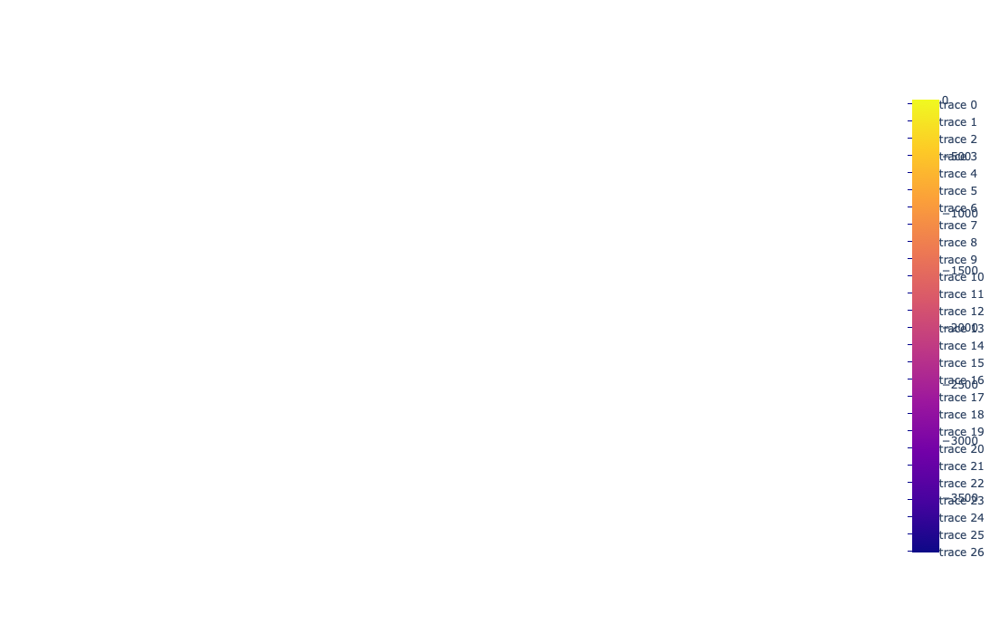

In [14]:
traj_plotter(traj_fine, np.random.randint(0, traj_fine.traj.shape[0], 50), topography=-topography)

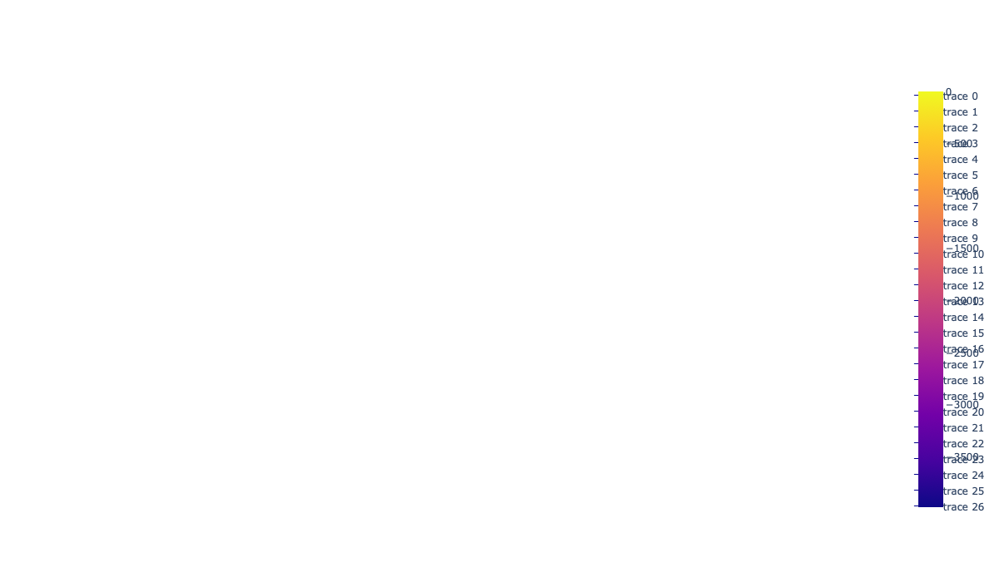

In [15]:
traj_plotter(traj_coarse, np.random.randint(0, traj_coarse.traj.shape[0], 50), topography=-topography)

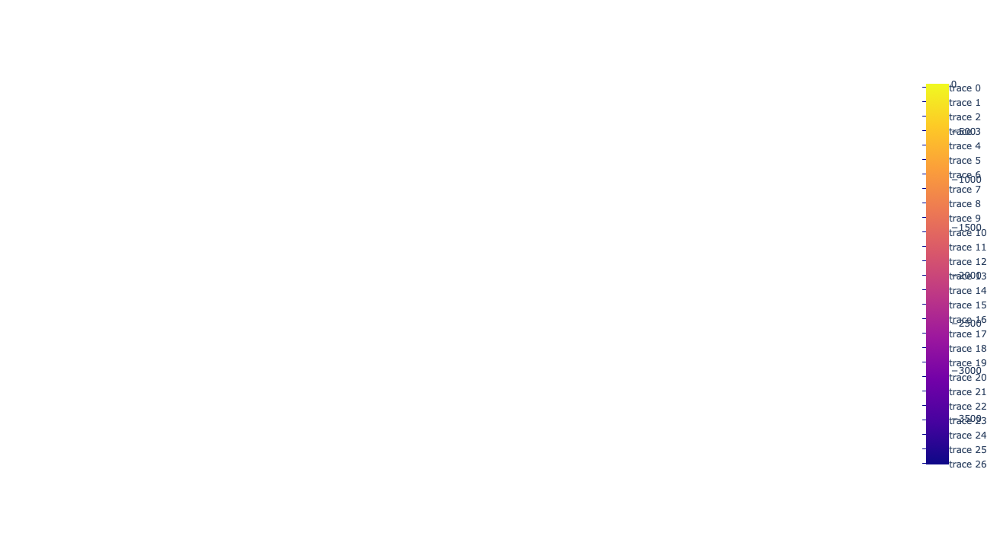

In [18]:
traj_plotter(traj_coarsened, np.random.randint(0, traj_coarsened.traj.shape[0], 50), topography=-topography)

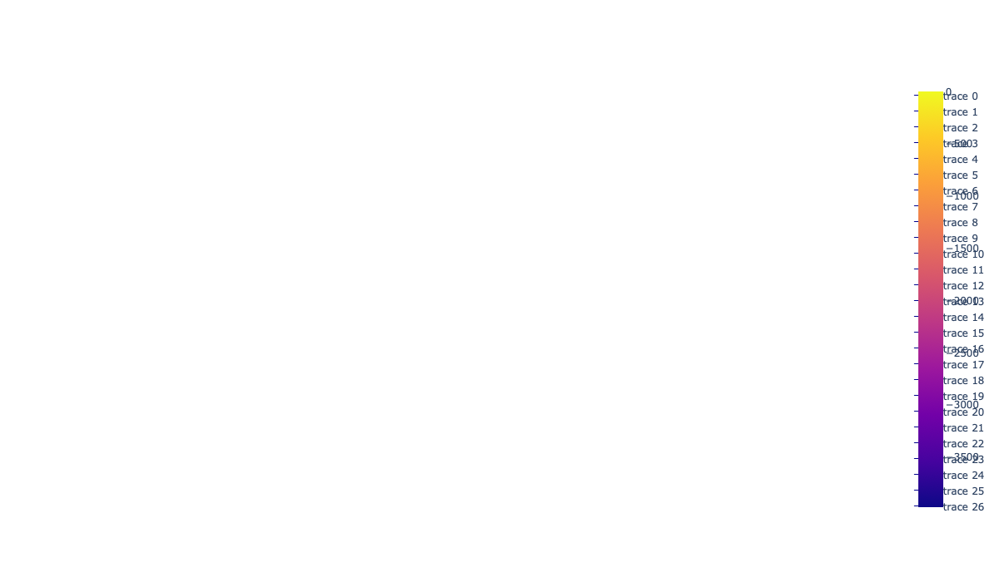

In [19]:
traj_plotter(traj_coarse_markov1, np.random.randint(0, traj_coarse_markov1.traj.shape[0], 50), topography=-topography)

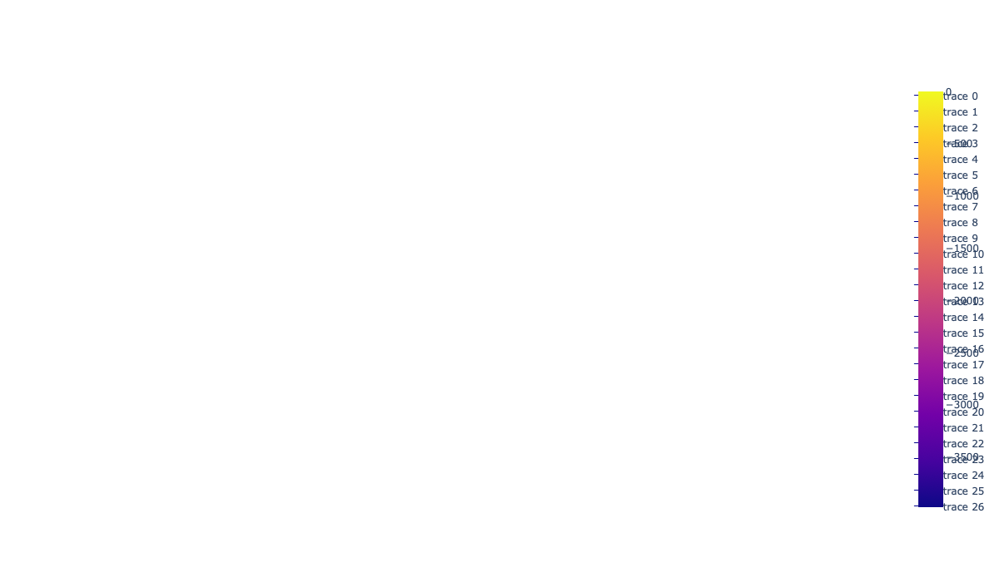

In [20]:
traj_plotter(traj_coarsened_markov1, np.random.randint(0, traj_coarsened_markov1.traj.shape[0], 50), topography=-topography)

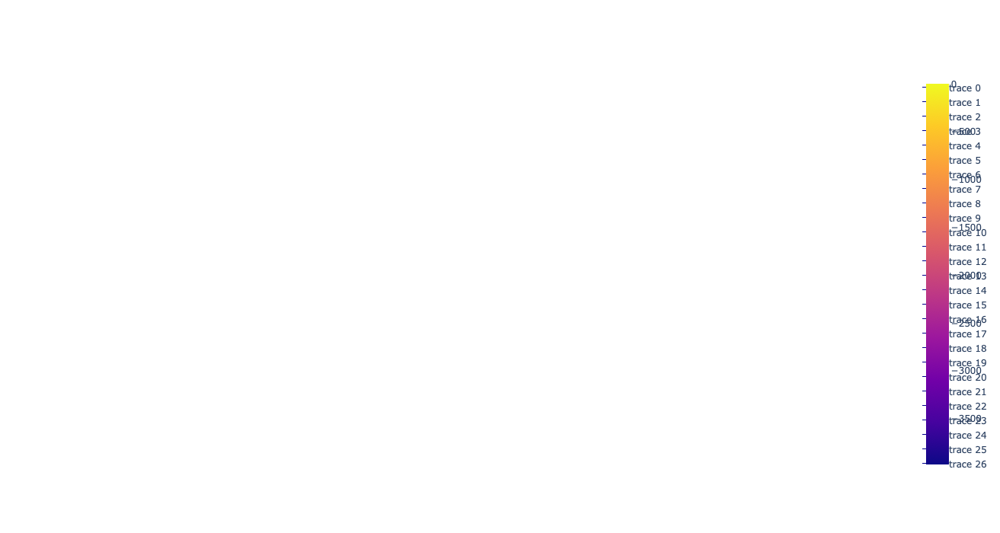

In [6]:
traj_plotter(traj_coarsened_Redi, np.random.randint(0, traj_coarsened_Redi.traj.shape[0], 50), topography=-topography)


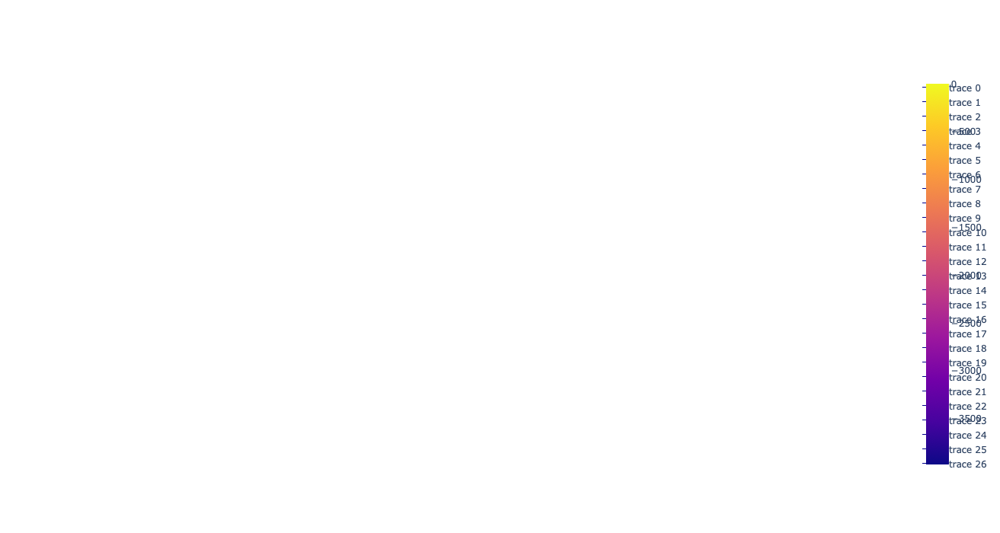

In [8]:
traj_plotter(traj_coarsened_Redi_no_diapyc, np.random.randint(0, traj_coarsened_Redi_no_diapyc.traj.shape[0], 50), topography=-topography)

